# Missing values

Retrieve variables from other notebooks:

In [31]:
%store -r df
%store -r cat_cols
%store -r num_cols
%store -r data_retrieval_protocol

In [32]:
len(num_cols)

113

In [34]:
len(cat_cols)

102

In [4]:
df.head()

,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,...,avg_AMT_CREDIT_SUM_OVERDUE_CAT,count_CREDIT_TYPE_Mortgage_CAT,count_CREDIT_TYPE_Car_loan_CAT,count_CREDIT_TYPE_Microloan_CAT,avg_AMT_DRAWINGS_OTHER_CURRENT_CAT,sum_CNT_DRAWINGS_OTHER_CURRENT_CAT,max_Unpaid_balance_CAT,avg_SK_DPD_CAT,avg_SK_DPD_DEF_CAT,count_CODE_REJECT_REASON_HC_CAT
SK_ID_CURR,,,,,,,,,,,,,,,,,,,,,
100002,1,Cash loans,M,0,1,12.218495,406597.5,10.114579,12.768542,Unaccompanied,...,0,0,0,0,Other,Other,0,0,0,0
100003,0,Cash loans,F,0,0,12.506177,1293502.5,10.482864,13.937286,Family,...,0,0,0,0,Other,Other,0,0,0,0
100004,0,Revolving loans,M,1,1,11.119883,135000.0,8.817298,11.813030,Unaccompanied,...,0,0,0,0,Other,Other,0,0,0,0
100006,0,Cash loans,F,0,1,11.813030,312682.5,10.298448,12.601487,Unaccompanied,...,Other,Other,Other,Other,Other,Other,0,0,0,0
100007,0,Cash loans,M,0,1,11.707670,513000.0,9.992665,13.148031,Unaccompanied,...,0,0,0,0,Other,Other,0,0,0,0


In [35]:
df.shape

(307511, 215)

In [36]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats

from sklearn.impute import KNNImputer

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [7]:
num_cols

['AMT_INCOME_TOTAL',
 'AMT_CREDIT',
 'AMT_ANNUITY',
 'AMT_GOODS_PRICE',
 'REGION_POPULATION_RELATIVE',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_REGISTRATION',
 'DAYS_ID_PUBLISH',
 'OWN_CAR_AGE',
 'OCCUPATION_TYPE',
 'HOUR_APPR_PROCESS_START',
 'ORGANIZATION_TYPE',
 'EXT_SOURCE_1',
 'EXT_SOURCE_2',
 'EXT_SOURCE_3',
 'APARTMENTS_AVG',
 'BASEMENTAREA_AVG',
 'YEARS_BEGINEXPLUATATION_AVG',
 'YEARS_BUILD_AVG',
 'COMMONAREA_AVG',
 'ELEVATORS_AVG',
 'ENTRANCES_AVG',
 'FLOORSMAX_AVG',
 'FLOORSMIN_AVG',
 'LANDAREA_AVG',
 'LIVINGAPARTMENTS_AVG',
 'LIVINGAREA_AVG',
 'NONLIVINGAPARTMENTS_AVG',
 'NONLIVINGAREA_AVG',
 'APARTMENTS_MODE',
 'BASEMENTAREA_MODE',
 'YEARS_BEGINEXPLUATATION_MODE',
 'YEARS_BUILD_MODE',
 'COMMONAREA_MODE',
 'ENTRANCES_MODE',
 'FLOORSMAX_MODE',
 'FLOORSMIN_MODE',
 'LANDAREA_MODE',
 'LIVINGAPARTMENTS_MODE',
 'LIVINGAREA_MODE',
 'NONLIVINGAPARTMENTS_MODE',
 'NONLIVINGAREA_MODE',
 'APARTMENTS_MEDI',
 'BASEMENTAREA_MEDI',
 'YEARS_BEGINEXPLUATATION_MEDI',
 'YEARS_BUILD_MEDI',
 'COMM

In [37]:
binary_missing_matrix = pd.DataFrame(np.where(df.notnull(), 0, 1), columns=df.columns, index=df.index)

In [38]:
binary_missing_matrix.shape

(307511, 215)

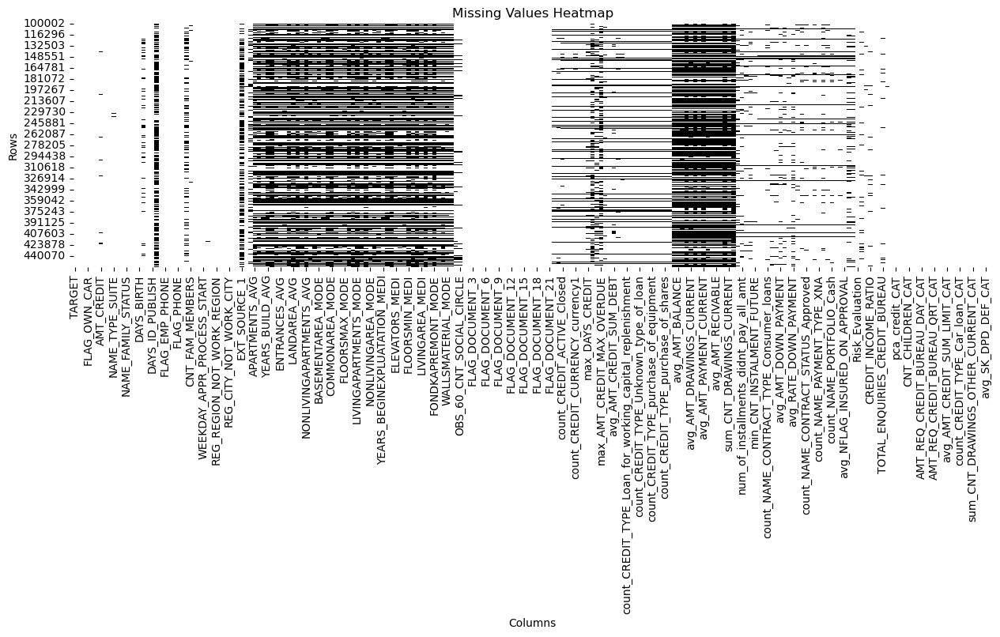

In [10]:
# Create a heatmap using Seaborn
plt.figure(figsize=(15,4))

sns.heatmap(binary_missing_matrix, cmap='binary', cbar=False)

# Set plot properties
plt.title('Missing Values Heatmap')
plt.xlabel('Columns')
plt.ylabel('Rows')

# Display the heatmap
plt.show()

In [39]:
def create_missing_dataframe(binary_missing_matrix):
        
    missing_counts = []
    
    # Iterate over each column in the binary missing matrix
    for column in binary_missing_matrix.columns:
        
        # Calculate the missing count
        missing_count = binary_missing_matrix[column].sum()
        missing_counts.append(missing_count)
    
    # Calculate the percentage of missing values for each column
    total_rows = binary_missing_matrix.shape[0]
    percentages_missing = [(count / total_rows) * 100 for count in missing_counts]
    
    # Create the dataframe
    missing_df = pd.DataFrame({
        'column_name': binary_missing_matrix.columns,
        'missing_count': missing_counts,
        '%missing': percentages_missing
    })
    
    # Sort the dataframe by '%missing' column in descending order
    missing_df = missing_df.sort_values('%missing', ascending=False)

    return missing_df


In [40]:
missing_df = create_missing_dataframe(binary_missing_matrix)
missing_df

,column_name,missing_count,%missing
154,sum_CNT_DRAWINGS_POS_CURRENT,254104,82.632491
152,sum_CNT_DRAWINGS_ATM_CURRENT,249619,81.174007
147,avg_AMT_PAYMENT_CURRENT,246451,80.143800
145,avg_AMT_DRAWINGS_POS_CURRENT,246371,80.117784
143,avg_AMT_DRAWINGS_ATM_CURRENT,246371,80.117784
148,avg_AMT_PAYMENT_TOTAL_CURRENT,228016,74.148892
144,avg_AMT_DRAWINGS_CURRENT,227024,73.826302
142,avg_AMT_CREDIT_LIMIT_ACTUAL,226533,73.666633
140,count_MONTHS_BALANCE,220608,71.739873
149,avg_AMT_RECEIVABLE_PRINCIPAL,220606,71.739222


In [21]:
merged_df = data_retrieval_protocol.merge(missing_df, left_on='Feature name', right_on='column_name', how='left')
data_retrieval_protocol['Num_of_Nulls'] = merged_df['missing_count']
data_retrieval_protocol['%missing'] = merged_df['%missing']

data_retrieval_protocol

,Feature name,Source,Data type,Unique count,Min,Max,Num_of_Outliers,Outlier treatment,Num_of_Nulls,Null treatment,Description,%missing
0,TARGET,NaN,int64,2,0,1,NaN,NaN,0.0,NaN,NaN,0.000000
1,NAME_CONTRACT_TYPE,NaN,object,2,Revolving loans,Cash loans,NaN,NaN,0.0,NaN,NaN,0.000000
2,CODE_GENDER,NaN,object,3,XNA,F,NaN,NaN,0.0,NaN,NaN,0.000000
3,FLAG_OWN_CAR,NaN,int64,2,0,1,NaN,NaN,0.0,NaN,NaN,0.000000
4,FLAG_OWN_REALTY,NaN,int64,2,0,1,NaN,NaN,0.0,NaN,NaN,0.000000
5,CNT_CHILDREN,NaN,int64,15,0,19,NaN,NaN,NaN,NaN,NaN,NaN
6,AMT_INCOME_TOTAL,NaN,float64,2548,25650.0,117000000.0,14035 (4.56),log transformation,0.0,NaN,NaN,0.000000
7,AMT_CREDIT,NaN,float64,5603,45000.0,4050000.0,6562 (2.13),replace with NaN,6562.0,NaN,NaN,2.133907
8,AMT_ANNUITY,NaN,float64,13673,1615.5,258025.5,7504 (2.44),log transformation,12.0,NaN,NaN,0.003902
9,AMT_GOODS_PRICE,NaN,float64,1003,40500.0,4050000.0,14728 (4.79),log transformation,278.0,NaN,NaN,0.090403


In [172]:
missing_df[missing_df['column_name'] == 'avg_AMT_PAYMENT_CURRENT']


,column_name,missing_count,%missing
147,avg_AMT_PAYMENT_CURRENT,246451,80.1438


In [41]:
## Divide the missing columns to 3 groups based on the percentage of missing values in each column

missing_less_than_40 = missing_df[(missing_df['%missing'] < 40)  & (missing_df['%missing'] > 0)]['column_name'].to_list()
missing_between_40_70 = missing_df[(missing_df['%missing'] >= 40) & (missing_df['%missing'] < 70)]['column_name'].to_list()
missing_more_than_70 = missing_df[missing_df['%missing'] >= 70]['column_name'].to_list()

In [42]:
missing_0 = missing_df[missing_df['%missing'] == 0]['column_name'].to_list()
len(missing_0)

75

In [43]:
len(missing_less_than_40)

74

In [44]:
missing_less_than_40

['OCCUPATION_TYPE',
 'max_DAYS_ENDDATE_FACT',
 'max_DAYS_TERMINATION',
 'max_DAYS_CREDIT',
 'EXT_SOURCE_3',
 'DAYS_EMPLOYED',
 'max_CNT_CREDIT_PROLONG',
 'count_CREDIT_ACTIVE_Closed',
 'count_CREDIT_TYPE_Consumer_credit',
 'avg_AMT_CREDIT_SUM_DEBT',
 'count_CREDIT_TYPE_Creditc_card',
 'count_CREDIT_CURRENCY_currency1',
 'max_num_days_of_payment_late',
 'AMT_REQ_CREDIT_BUREAU_YEAR',
 'avg_RATE_DOWN_PAYMENT',
 'max_DAYS_CREDIT_UPDATE',
 'avg_AMT_CREDIT_SUM',
 'count_CREDIT_ACTIVE_Active',
 'count_CREDIT_CURRENCY_currency4',
 'count_CREDIT_CURRENCY_currency3',
 'count_CREDIT_ACTIVE_Bad_debt',
 'count_CREDIT_TYPE_purchase_of_shares',
 'count_CREDIT_TYPE_Interbank_credit',
 'count_CREDIT_TYPE_Mobile_operator_loan',
 'count_CREDIT_TYPE_purchase_of_equipment',
 'count_CREDIT_TYPE_Cash_loan',
 'count_CREDIT_TYPE_Another_type_of_loan',
 'count_CREDIT_TYPE_Unknown_type_of_loan',
 'count_CREDIT_TYPE_Real_estate_loan',
 'count_CREDIT_TYPE_Loan_for_business_development',
 'count_CREDIT_TYPE_Loan_fo

In [47]:
len(missing_between_40_70)

48

In [48]:
len(missing_more_than_70)

18

In [49]:
numeric_missing_columns = [col for col in missing_less_than_40 if col in (num_cols)]
#col for col in num_cols if col not in columns_to_drop
len(numeric_missing_columns)

46

In [50]:
categorical_missing_columns = [col for col in missing_less_than_40 if col in (cat_cols)]
len(categorical_missing_columns)

28

## Find the mechanism of creating the missing values

## Using statistical methods

For numerical variables we will use the Kolmogorov-Smirnov test which shows the differences in the distributions, and for the categorical variables we will use the chi2 test.

In [52]:
################################
### Missing values - Python
################################


def MissingMechanism(df, binary_missing_matrix, numeric_missing_columns,categorical_missing_columns, significant_level=0.05):

    distribution_change_df = {} #pd.DataFrame()
    i = 0
    # Numerical variables

    for numeric_missing_column_name in numeric_missing_columns: # -> only numeric variables that have missing values    
        df_without_na = df[binary_missing_matrix[numeric_missing_column_name] == 0]
        for numeric_column_name in num_cols: # -> all numeric variables in data: with and without missing values
            if numeric_missing_column_name != numeric_column_name:
                #print(numeric_missing_column_name)
                #print(numeric_column_name)
                series_with_na = df[numeric_column_name]
                series_without_na = df_without_na[numeric_column_name]
                ks_result = stats.ks_2samp(series_with_na, series_without_na)
                #distribution_change_df.append(
                distribution_change_df[i] = dict(    
                    {
                        'var_1_missing' : numeric_missing_column_name,
                        'var_2': numeric_column_name,
                        'missings_number': sum(binary_missing_matrix[numeric_missing_column_name]), #len(df[numeric_missing_column_name]) - len(df[numeric_column_name]), 
                        'distribution_changed': '+' if ks_result[1] < significant_level else '-', #  ftz_result[1] -> gives us the p-value
                        'imputation': 'no' if (ks_result[1] < significant_level) else 'yes'
                    })
                #print(i)
                i = i + 1
                    
        # Categorical variables
    for categorical_missing_column_name in categorical_missing_columns:
        df_without_na = df[binary_missing_matrix[categorical_missing_column_name] == 0]
        for categorical_column_name in cat_cols:
            if categorical_missing_column_name != categorical_column_name:
                contingency_table = pd.crosstab(df[categorical_column_name], df[categorical_missing_column_name])
                chi2_result = stats.chi2_contingency(contingency_table)
                distribution_change_df[i] = {
                    'var_1_missing': categorical_missing_column_name,
                    'var_2': categorical_column_name,
                    'missings_number': sum(binary_missing_matrix[categorical_missing_column_name]),
                    'distribution_changed': '+' if chi2_result[1] < significant_level else '-',
                    'imputation': 'no' if chi2_result[1] < significant_level else 'yes'
                }
                i += 1

    return pd.DataFrame(distribution_change_df).transpose()


In [53]:

missing_Remove_Decisions = MissingMechanism(df, binary_missing_matrix, numeric_missing_columns, categorical_missing_columns)

missing_Remove_Decisions = pd.DataFrame(missing_Remove_Decisions)
missing_Remove_Decisions

,var_1_missing,var_2,missings_number,distribution_changed,imputation
0,max_DAYS_ENDDATE_FACT,AMT_INCOME_TOTAL,91663,+,no
1,max_DAYS_ENDDATE_FACT,AMT_CREDIT,91663,+,no
2,max_DAYS_ENDDATE_FACT,AMT_ANNUITY,91663,+,no
3,max_DAYS_ENDDATE_FACT,AMT_GOODS_PRICE,91663,+,no
4,max_DAYS_ENDDATE_FACT,REGION_POPULATION_RELATIVE,91663,+,no
5,max_DAYS_ENDDATE_FACT,DAYS_BIRTH,91663,+,no
6,max_DAYS_ENDDATE_FACT,DAYS_EMPLOYED,91663,+,no
7,max_DAYS_ENDDATE_FACT,DAYS_REGISTRATION,91663,-,yes
8,max_DAYS_ENDDATE_FACT,DAYS_ID_PUBLISH,91663,+,no
9,max_DAYS_ENDDATE_FACT,OWN_CAR_AGE,91663,+,no


In [27]:
df['max_DAYS_ENDDATE_FACT'].dtype

dtype('float64')

In [54]:
len(missing_Remove_Decisions)

7980

"+" means that there is a difference in the distribution of this variable with and without the missing values.We will filter all the results with a p-value smaller than 0.05. The meaning of p-value smaller than 0.05 is that this column is not 'MAR' (Missing At Random) and we can't impute.


In [55]:
## Missing Not At Random

MNAR = missing_Remove_Decisions[missing_Remove_Decisions.imputation == 'no']
MNAR

,var_1_missing,var_2,missings_number,distribution_changed,imputation
0,max_DAYS_ENDDATE_FACT,AMT_INCOME_TOTAL,91663,+,no
1,max_DAYS_ENDDATE_FACT,AMT_CREDIT,91663,+,no
2,max_DAYS_ENDDATE_FACT,AMT_ANNUITY,91663,+,no
3,max_DAYS_ENDDATE_FACT,AMT_GOODS_PRICE,91663,+,no
4,max_DAYS_ENDDATE_FACT,REGION_POPULATION_RELATIVE,91663,+,no
5,max_DAYS_ENDDATE_FACT,DAYS_BIRTH,91663,+,no
6,max_DAYS_ENDDATE_FACT,DAYS_EMPLOYED,91663,+,no
8,max_DAYS_ENDDATE_FACT,DAYS_ID_PUBLISH,91663,+,no
9,max_DAYS_ENDDATE_FACT,OWN_CAR_AGE,91663,+,no
11,max_DAYS_ENDDATE_FACT,EXT_SOURCE_1,91663,+,no


In [56]:
MNAR_columns = MNAR.var_1_missing.unique()
len(MNAR_columns)

65

In [57]:
MNAR_columns

array(['max_DAYS_ENDDATE_FACT', 'max_DAYS_TERMINATION', 'max_DAYS_CREDIT',
       'EXT_SOURCE_3', 'DAYS_EMPLOYED', 'count_CREDIT_ACTIVE_Closed',
       'count_CREDIT_TYPE_Consumer_credit', 'avg_AMT_CREDIT_SUM_DEBT',
       'count_CREDIT_CURRENCY_currency1', 'max_num_days_of_payment_late',
       'avg_RATE_DOWN_PAYMENT', 'max_DAYS_CREDIT_UPDATE',
       'avg_AMT_CREDIT_SUM', 'count_CREDIT_ACTIVE_Active',
       'min_DAYS_TERMINATION', 'num_of_installments_didnt_pay_all_amt',
       'avg_AMT_GOODS_PRICE', 'avg_AMT_APPLICATION', 'avg_AMT_CREDIT',
       'avg_AMT_DOWN_PAYMENT', 'count_CODE_REJECT_REASON_XAP',
       'count_MONTHS_BALANCE.1', 'min_CNT_INSTALMENT',
       'count_NAME_PAYMENT_TYPE_Cash_through_the_bank',
       'count_NAME_CONTRACT_STATUS_Approved', 'avg_DAYS_DECISION',
       'count_NAME_CASH_LOAN_PURPOSE_XAP', 'min_CNT_INSTALMENT_FUTURE',
       'avg_NFLAG_INSURED_ON_APPROVAL', 'INCOME_PER_MEMBER',
       'count_pa_SK_ID_PREV', 'count_NAME_CONTRACT_TYPE_Cash_loans',
       

In [58]:
## Missing At Random

MAR = missing_Remove_Decisions[missing_Remove_Decisions.imputation == 'yes']
MAR

,var_1_missing,var_2,missings_number,distribution_changed,imputation
7,max_DAYS_ENDDATE_FACT,DAYS_REGISTRATION,91663,-,yes
10,max_DAYS_ENDDATE_FACT,HOUR_APPR_PROCESS_START,91663,-,yes
108,max_DAYS_ENDDATE_FACT,CREDIT_INCOME_RATIO,91663,-,yes
121,max_DAYS_TERMINATION,OWN_CAR_AGE,65075,-,yes
218,max_DAYS_TERMINATION,INCOME_PER_MEMBER,65075,-,yes
220,max_DAYS_TERMINATION,CREDIT_INCOME_RATIO,65075,-,yes
234,max_DAYS_CREDIT,HOUR_APPR_PROCESS_START,64556,-,yes
241,max_DAYS_CREDIT,YEARS_BUILD_AVG,64556,-,yes
242,max_DAYS_CREDIT,COMMONAREA_AVG,64556,-,yes
246,max_DAYS_CREDIT,FLOORSMIN_AVG,64556,-,yes


In [59]:
MAR_columns = MAR.var_1_missing.unique()
len(MAR_columns)

74

Remove elements from the second list (MAR) that appear in the first list (MNAR_columns)

In [60]:
MAR_columns_filtered = [x for x in MAR_columns if x not in MNAR_columns]
MAR_columns_filtered

['HOUR_APPR_PROCESS_START',
 'EXT_SOURCE_2',
 'DAYS_REGISTRATION',
 'DAYS_LAST_PHONE_CHANGE',
 'AMT_GOODS_PRICE',
 'AVERAGE_EXT_SOURCE',
 'Risk_Evaluation',
 'AMT_ANNUITY',
 'max_CNT_CREDIT_PROLONG']

In [61]:
len(MAR_columns_filtered)

9

### Visualiize the MNAR columns

### Graphically - looking at the distributions

In [62]:
MNAR_num_columns = [col for col in MNAR_columns if col in num_cols]
len(MNAR_num_columns)

38

In [63]:
MNAR_cat_columns = [col for col in MNAR_columns if col in cat_cols]
len(MNAR_cat_columns)

27

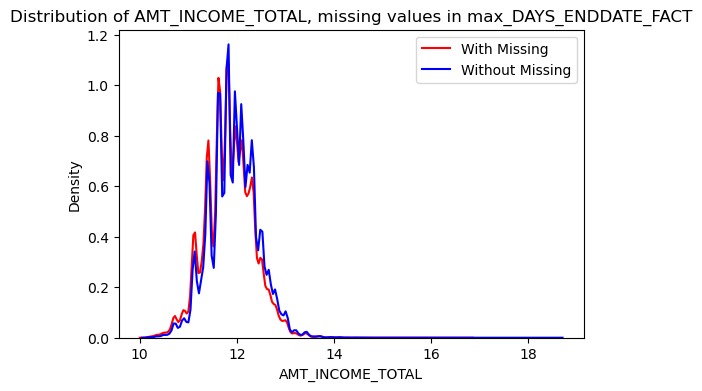

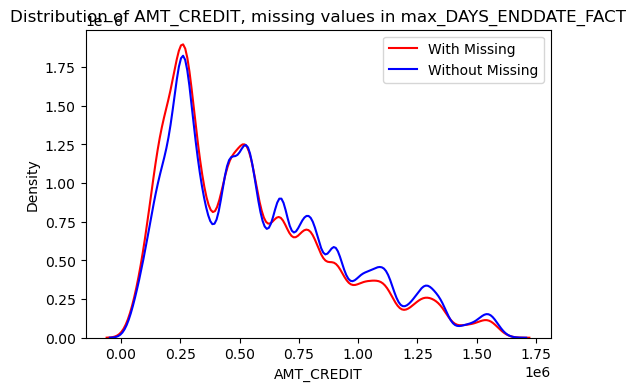

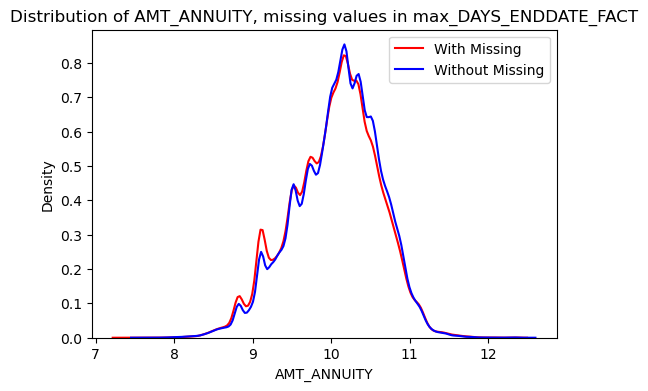

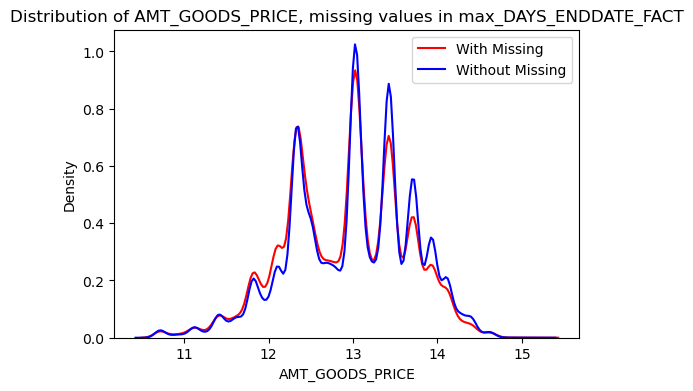

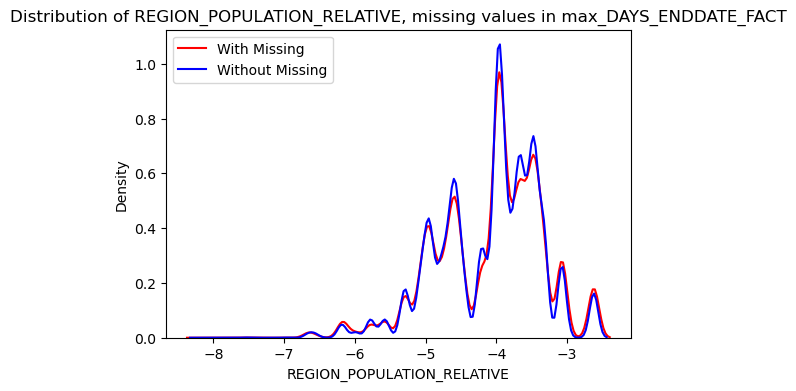

...

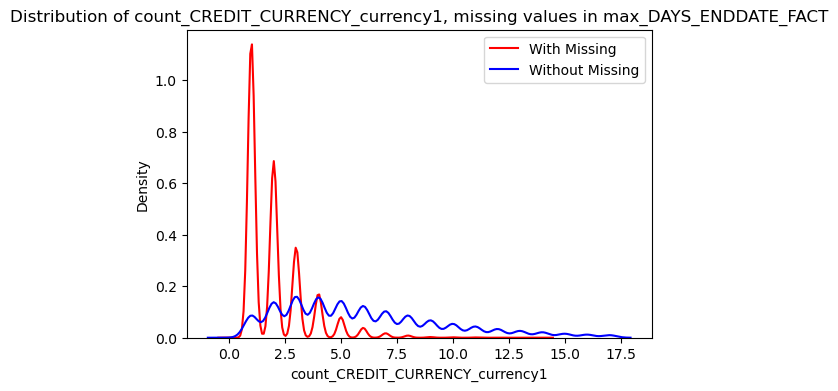

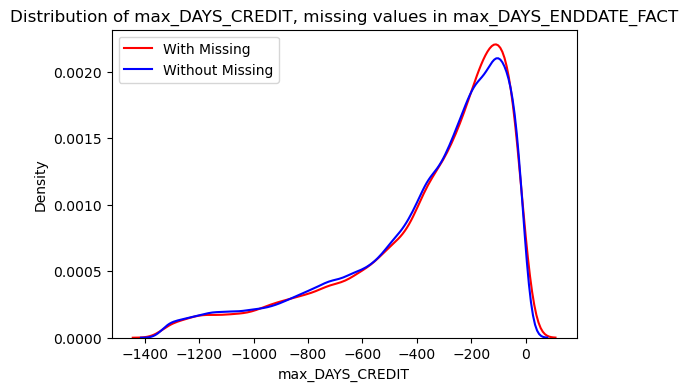

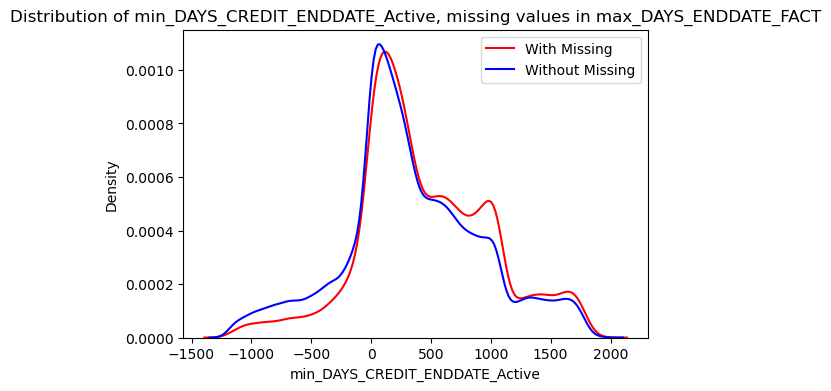

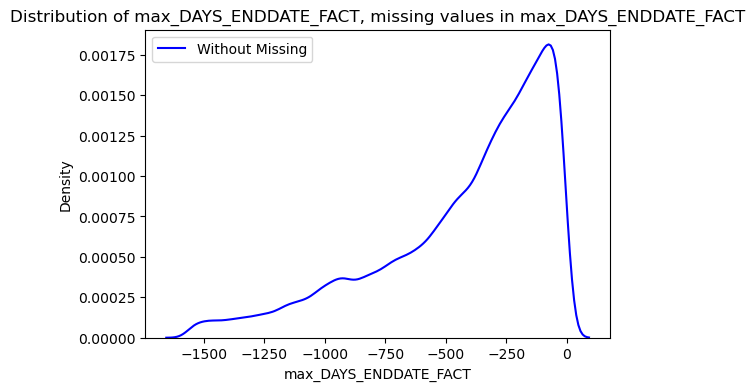

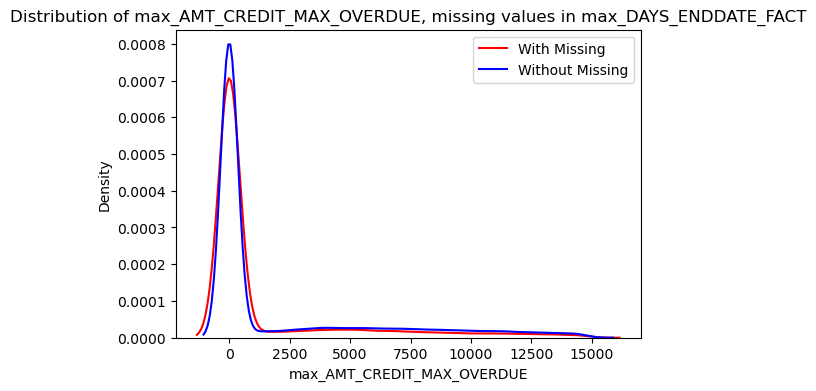

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


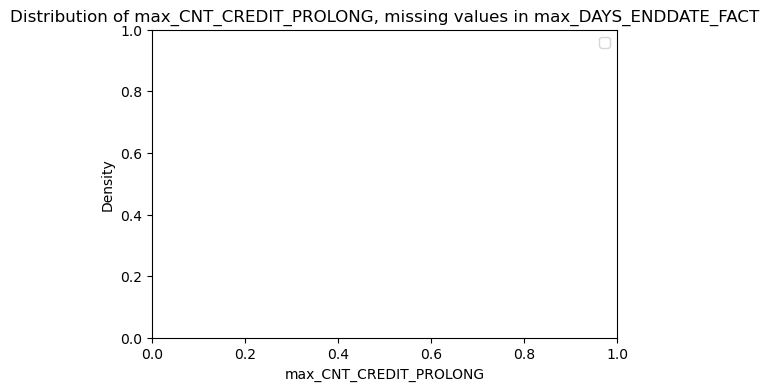

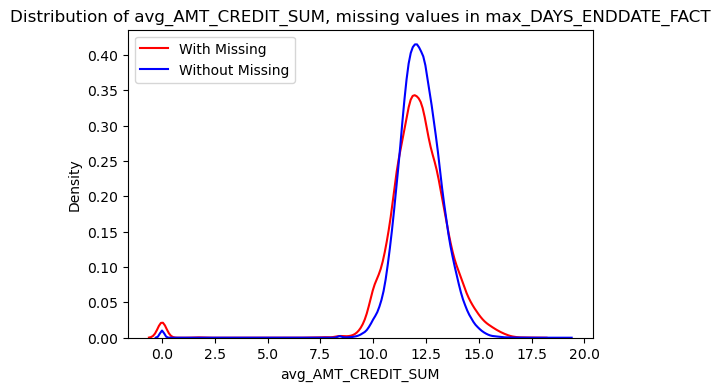

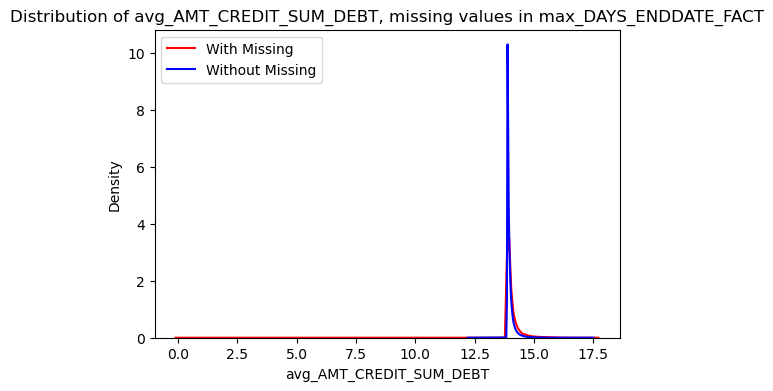

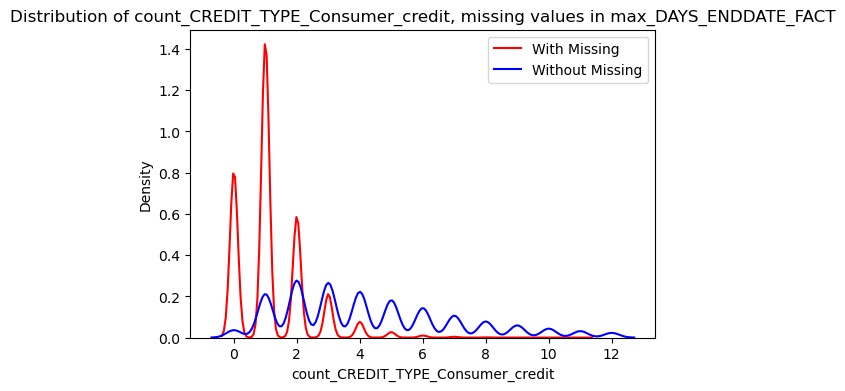

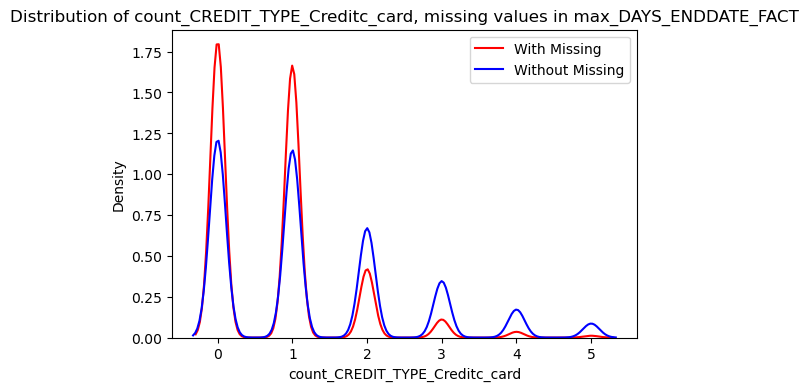

...

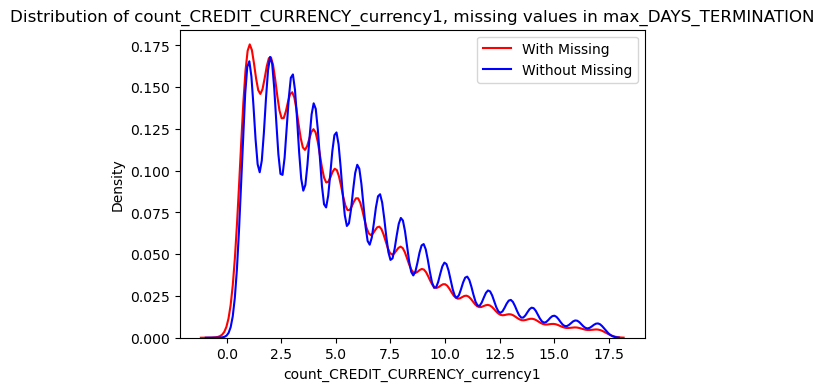

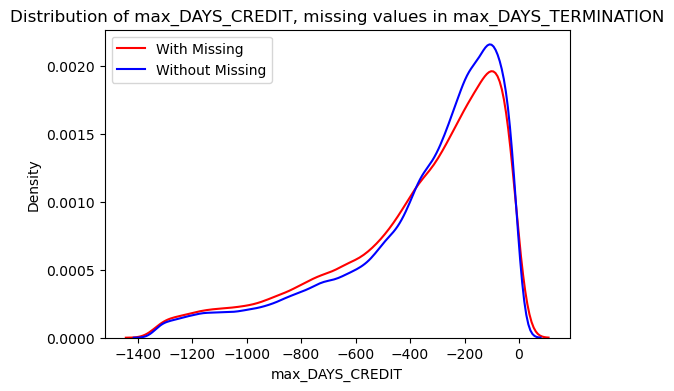

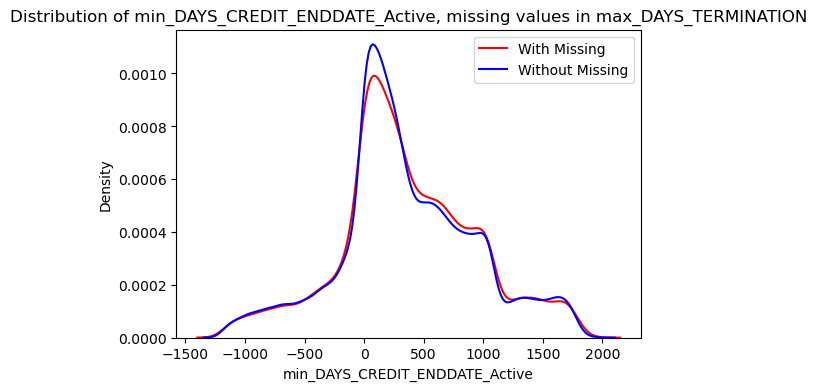

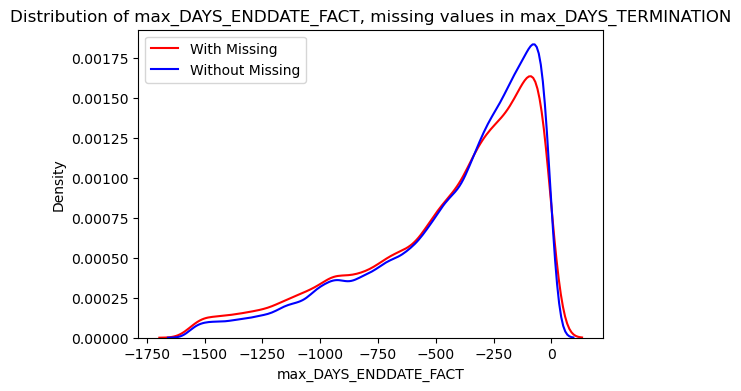

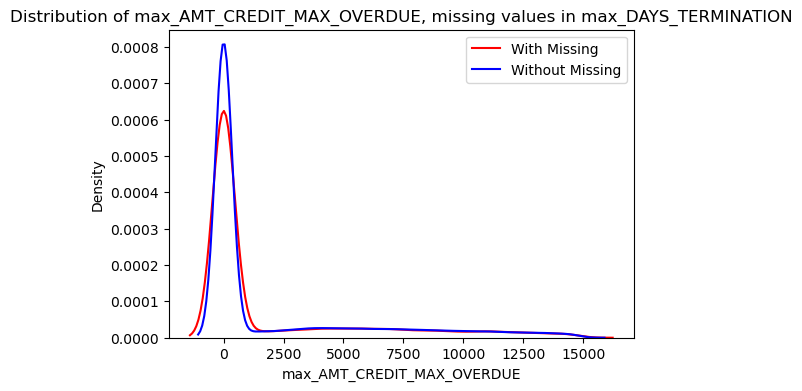

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


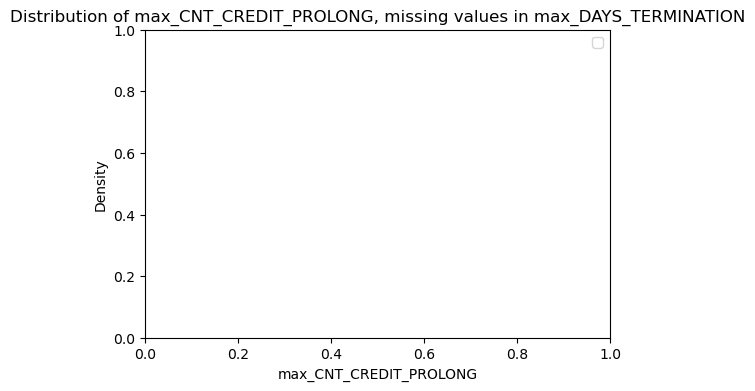

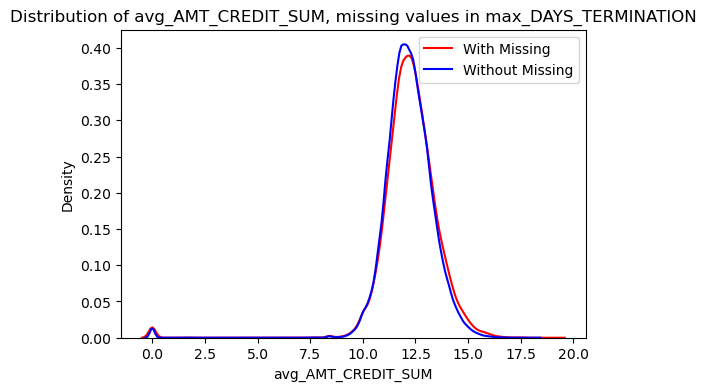

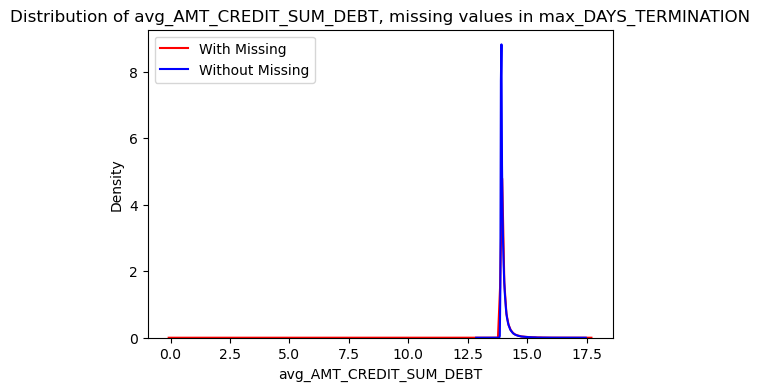

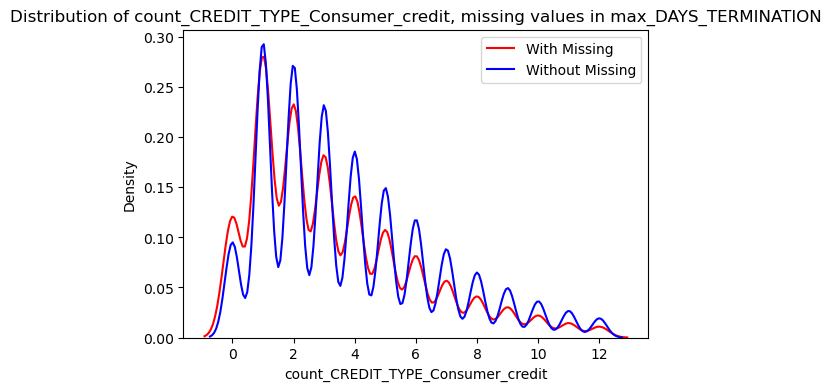

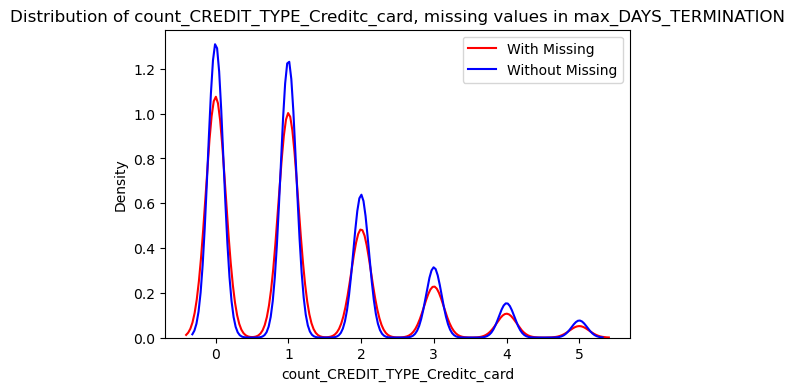

...

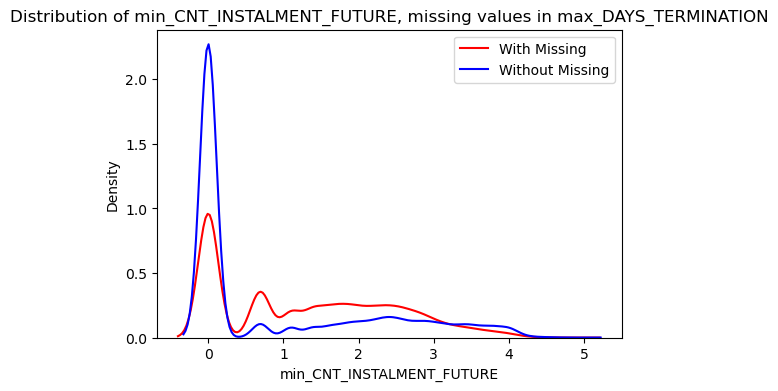

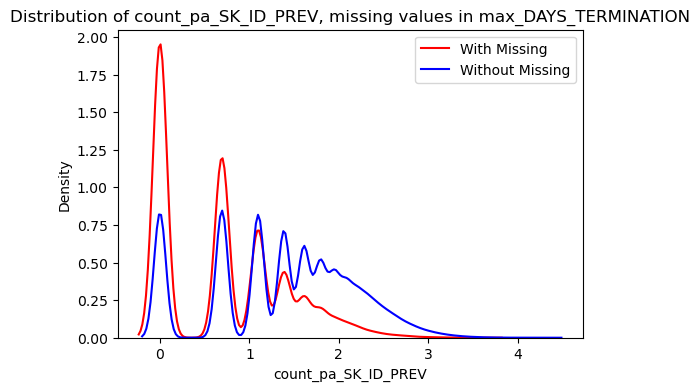

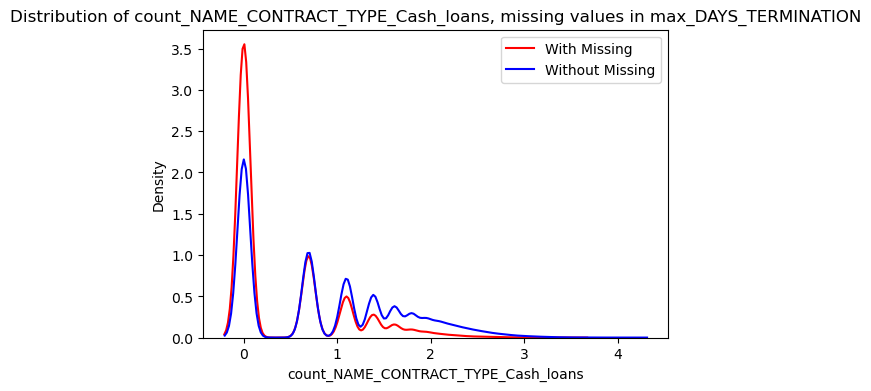

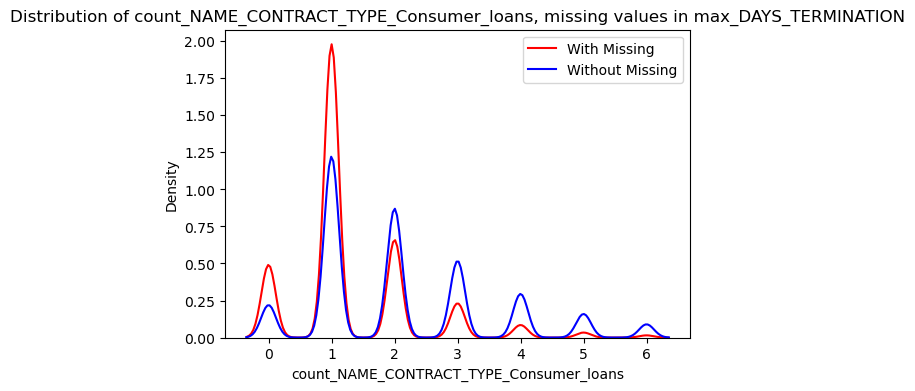

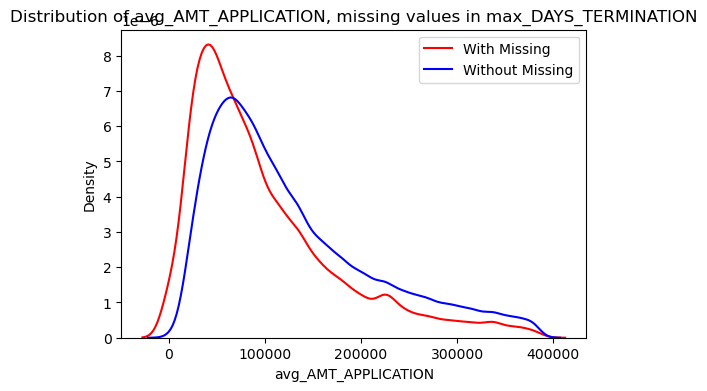

KeyboardInterrupt: 

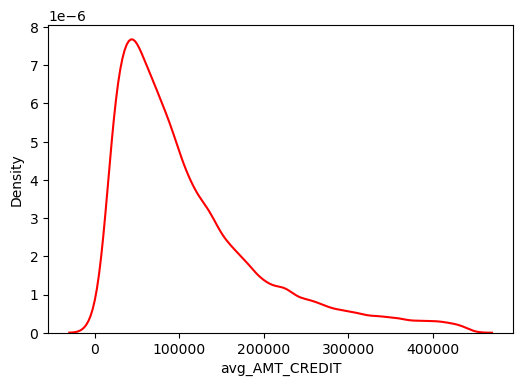

In [36]:
for column in MNAR_num_columns:
    
    for other_column in (num_cols):        
        plt.figure(figsize=(6, 4))
        # Plot distribution with missing values
        sns.kdeplot(data=df[df[column].isnull()], x=other_column, label='With Missing', color='red', warn_singular=False)
        
        # Plot distribution without missing values
        sns.kdeplot(data=df[df[column].notnull()], x=other_column, label='Without Missing', color='blue', warn_singular=False)
        
        plt.title(f"Distribution of {other_column}, missing values in {column}")
        plt.legend()
        plt.show()
    # Set title for the figure
    #plt.suptitle(f"Distributions for {column}", fontsize=16)


## Handle Missing Values

In [64]:

def calculate_row_missing_percentage(binary_missing_matrix, df):
    
    # Calculate the count of missing values per row
    missing_counts = binary_missing_matrix.sum(axis=1)
    
    # Calculate the percentage of missing values for each row
    total_columns = binary_missing_matrix.shape[1]
    percentages_missing = (missing_counts / total_columns) * 100
    
    # Create a DataFrame to store the results
    result_df = pd.DataFrame({
        'row_missing_%': percentages_missing,
        'count': 1
    })
    
    # Group the results by the row_missing_% and calculate the count
    result_df = result_df.groupby('row_missing_%').count().reset_index()
    
    # Set the values for the 'row_missing_%' column using .loc
    df.loc[:, 'row_missing_%'] = percentages_missing
    return result_df, df


In [65]:
result_df, df= calculate_row_missing_percentage(binary_missing_matrix, df)
print(result_df.sort_values('row_missing_%', ascending=False).round(3))


     row_missing_%  count
126         58.605      4
125         58.140     15
124         57.674     33
123         57.209     91
122         56.744    101
121         56.279    261
120         55.814    221
119         55.349     80
118         54.884     45
117         54.419     33
116         53.953     26
115         53.488     12
114         53.023     10
113         52.558      6
112         52.093      9
111         51.628      5
110         51.163      8
109         50.698      8
108         50.233     12
107         49.767     10
106         49.302     11
105         48.837     22
104         48.372     33
103         47.907     42
102         47.442     66
101         46.977     90
100         46.512    164
99          46.047    304
98          45.581    489
97          45.116   1054
96          44.651   1727
95          44.186   3210
94          43.721   3598
93          43.256   4618
92          42.791   3814
91          42.326   1472
90          41.860    457
89          

In [66]:
# Delete all rows with more than 50% missing values

rows_missing_more_than_50_count = (df['row_missing_%'] > 50).sum()
df = df[df['row_missing_%'] <= 50]
print(f'{rows_missing_more_than_50_count} rows were deleted from the dataset df')
df = df.drop('row_missing_%', axis=1)

980 rows were deleted from the dataset df


In [67]:
df.shape

(306531, 215)

In [68]:
def drop_columns(df, col_to_drop):
    """
    Drops the specified column(s) from the given dataframe.

    Args:
        df (pandas.DataFrame): The input dataframe.
        col_to_drop (str or list): Column name or list of column names to be dropped.

    Returns:
        pandas.DataFrame: The dataframe after dropping the specified column(s).
    """
    if isinstance(col_to_drop, str):
        col_to_drop = [col_to_drop]  # Convert single column name to a list

    df.drop(columns=col_to_drop, axis=1, inplace=True)
    return df


In [69]:
def create_missing_indicator(df, col_name):
    """
    Creates new variables indicating missing values based on the specified column(s).

    Args:
        df (pandas.DataFrame): The input dataframe.
        col_name (str or list): The name(s) of the column(s).

    Returns:
        pandas.DataFrame: The dataframe with new indicator columns and the original columns dropped.
    """
    if isinstance(col_name, str):
        col_name = [col_name]  # Convert single column name to a list

    for col in col_name:
        indicator_col_name = f"{col}_missing_indicator"  # New column name with suffix

        # Create the indicator column
        df[indicator_col_name] = df[col].isnull().astype(int)

    # Drop the original columns
    df.drop(columns=col_name, inplace=True)

    return df


In [70]:
def add_missing_category(df, col_name):
    """
    Converts a column in a DataFrame to a categorical variable and replaces missing values with 'Missing'.

    Parameters:
        df (DataFrame): The input DataFrame.
        col_name (str or list): The name of the column(s) to convert.
        
    Returns:
        DataFrame: The modified DataFrame with the converted column and missing values replaced.

    """
    if isinstance(col_name, str):
        col_name = [col_name]  # Convert single column name to a list
    
    for col in col_name:
        df[col] = df[col].astype('category').cat.add_categories('Missing')
        df[col] = df[col].fillna('Missing')

    return df


In [71]:
def create_iqr_quartile_columns(df, input_column_names):
    """
    Creates new columns with quartile labels based on the IQR (Interquartile Range) for each input column.

    Parameters:
    df (pandas.DataFrame): The input DataFrame.
    input_column_names (list): List of column names containing numerical values in df.

    Returns:
    pandas.DataFrame: The input DataFrame with new quartile columns added.
    """

    for input_column_name in input_column_names:
        input_column = df[input_column_name]

        # Calculate first quartile (Q1) and third quartile (Q3)
        q1 = input_column.quantile(0.25)
        q3 = input_column.quantile(0.75)

        # Calculate the interquartile range (IQR)
        iqr = q3 - q1

        def assign_quartile(val):
            """
            Assigns quartile labels based on the IQR and handles missing values.

            Parameters:
            val: A numerical value.

            Returns:
            str: Quartile label or 'missing' for missing values.
            """
            if pd.isnull(val):
                return 'missing'
            elif val < q1:
                return 'Q1'
            elif val <= q3:
                return 'Q2'
            else:
                return 'Q3'

        # Generate the new column name with '_iqr' suffix
        new_column_name = f'{input_column_name}_iqr'

        # Apply the quartile assignment function to the input column
        new_column = input_column.apply(assign_quartile)

        # Add the new column to the DataFrame
        df[new_column_name] = new_column

    return df


In [72]:
def impute_numerical_columns(df, col_name_to_impute, num_cols, cat_cols, n_neighbors=5):
    """
    Imputes missing values in specific columns of a DataFrame using K-Nearest Neighbors (KNN) imputation.

    Parameters:
        df (DataFrame): The input DataFrame.
        col_name_to_impute (str or list): The name of the column(s) to impute missing values.
        num_cols (list): The list of numerical column names.
        cat_cols (list): The list of categorical column names.
        n_neighbors (int, optional): The number of neighbors to consider in the KNN imputation.
                                     Default is 5.

    Returns:
        DataFrame: The modified DataFrame with the imputed values.

    """
    if isinstance(col_name_to_impute, str):
        col_name_to_impute = [col_name_to_impute]  # Convert single column name to a list

    imputer = KNNImputer(n_neighbors=n_neighbors)

    for col in col_name_to_impute:
        if df[col].isnull().sum() == 0:
            # No missing values in the column, move on to the next column
            continue
        if col in num_cols:
            # Numerical column
            df[col] = imputer.fit_transform(df[[col]])
        
    return df

In [73]:

def impute_categorical_columns(df, cols_to_impute):
    if isinstance(cols_to_impute, str):
        cols_to_impute = [cols_to_impute]  # Convert single column name to a list

    for col in cols_to_impute:
        mode_value = df[col].mode()[0]
        df[col].fillna(mode_value, inplace=True)
    
    return df


In [74]:
MAR

,var_1_missing,var_2,missings_number,distribution_changed,imputation
7,max_DAYS_ENDDATE_FACT,DAYS_REGISTRATION,91663,-,yes
10,max_DAYS_ENDDATE_FACT,HOUR_APPR_PROCESS_START,91663,-,yes
108,max_DAYS_ENDDATE_FACT,CREDIT_INCOME_RATIO,91663,-,yes
121,max_DAYS_TERMINATION,OWN_CAR_AGE,65075,-,yes
218,max_DAYS_TERMINATION,INCOME_PER_MEMBER,65075,-,yes
220,max_DAYS_TERMINATION,CREDIT_INCOME_RATIO,65075,-,yes
234,max_DAYS_CREDIT,HOUR_APPR_PROCESS_START,64556,-,yes
241,max_DAYS_CREDIT,YEARS_BUILD_AVG,64556,-,yes
242,max_DAYS_CREDIT,COMMONAREA_AVG,64556,-,yes
246,max_DAYS_CREDIT,FLOORSMIN_AVG,64556,-,yes


In [75]:
categorical_columns_to_impute = list(set(cat_cols) & set(MAR_columns_filtered))
categorical_columns_to_impute


['max_CNT_CREDIT_PROLONG']

In [76]:
numerical_columns_to_impute = list(set(num_cols) & set(MAR_columns_filtered))
numerical_columns_to_impute


['DAYS_LAST_PHONE_CHANGE',
 'EXT_SOURCE_2',
 'HOUR_APPR_PROCESS_START',
 'AMT_GOODS_PRICE',
 'AVERAGE_EXT_SOURCE',
 'DAYS_REGISTRATION',
 'AMT_ANNUITY',
 'Risk_Evaluation']

In [77]:
len(missing_more_than_70)

18

In [78]:
df[missing_more_than_70].head()

,sum_CNT_DRAWINGS_POS_CURRENT,sum_CNT_DRAWINGS_ATM_CURRENT,avg_AMT_PAYMENT_CURRENT,avg_AMT_DRAWINGS_POS_CURRENT,avg_AMT_DRAWINGS_ATM_CURRENT,avg_AMT_PAYMENT_TOTAL_CURRENT,avg_AMT_DRAWINGS_CURRENT,avg_AMT_CREDIT_LIMIT_ACTUAL,count_MONTHS_BALANCE,avg_AMT_RECEIVABLE_PRINCIPAL,avg_AMT_INST_MIN_REGULARITY,avg_AMT_BALANCE,avg_AMT_RECIVABLE,avg_AMT_TOTAL_RECEIVABLE,sum_CNT_DRAWINGS_CURRENT,LIVINGAPARTMENTS_MEDI,LIVINGAPARTMENTS_AVG,LIVINGAPARTMENTS_MODE
SK_ID_CURR,,,,,,,,,,,,,,,,,,
100002,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0205,0.0202,0.022
100003,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0787,0.0773,0.079
100004,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
100006,NaN,NaN,NaN,NaN,NaN,0.0,0.0,270000.0,6.0,7.983178,0.0,7.983178,7.983178,7.983178,0.0,NaN,NaN,NaN
100007,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [79]:
columns_to_create_missing_indicator = [
 'avg_AMT_PAYMENT_CURRENT',  # How much did the client pay during the month on the previous credit
 'avg_AMT_DRAWINGS_ATM_CURRENT', # Amount drawing at ATM during the month of the previous credit 
 'avg_AMT_DRAWINGS_POS_CURRENT', # Amount drawing or buying goods during the month of the previous credit
 'LIVINGAPARTMENTS_MEDI' # Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), 
    #median (_MEDI suffix) apartment size, common area,
    #living area, age of building, number of elevators, number of entrances, state of the building, number of floor
]

In [80]:
columns_to_drop = [col for col in missing_more_than_70 if col not in columns_to_create_missing_indicator]
columns_to_drop

['sum_CNT_DRAWINGS_POS_CURRENT',
 'sum_CNT_DRAWINGS_ATM_CURRENT',
 'avg_AMT_PAYMENT_TOTAL_CURRENT',
 'avg_AMT_DRAWINGS_CURRENT',
 'avg_AMT_CREDIT_LIMIT_ACTUAL',
 'count_MONTHS_BALANCE',
 'avg_AMT_RECEIVABLE_PRINCIPAL',
 'avg_AMT_INST_MIN_REGULARITY',
 'avg_AMT_BALANCE',
 'avg_AMT_RECIVABLE',
 'avg_AMT_TOTAL_RECEIVABLE',
 'sum_CNT_DRAWINGS_CURRENT',
 'LIVINGAPARTMENTS_AVG',
 'LIVINGAPARTMENTS_MODE']

In [81]:
len(missing_between_40_70)

48

In [82]:
len(MNAR_columns)

65

In [83]:
numeric_missing_columns_40_70 = [col for col in missing_between_40_70 if col in (num_cols)]
len(numeric_missing_columns_40_70)

43

In [84]:
cat_missing_columns_40_70 = [col for col in missing_between_40_70 if col in (cat_cols)]
len(cat_missing_columns_40_70)

5

In [85]:
len(MNAR_cat_columns)

27

In [86]:
num_colunms_to_convert_to_categorical = list(set(numeric_missing_columns_40_70) | set(MNAR_num_columns))
len(num_colunms_to_convert_to_categorical)


81

In [91]:
#num_colunms_to_convert_to_categorical

In [88]:
cat_colunms_to_convert_to_categorical = list(set(cat_missing_columns_40_70) | set(MNAR_cat_columns))
len(cat_colunms_to_convert_to_categorical)


32

In [89]:
cat_colunms_to_convert_to_categorical

['count_NAME_CONTRACT_TYPE_Consumer_loans',
 'count_CREDIT_TYPE_Mobile_operator_loan',
 'count_CREDIT_TYPE_Loan_for_business_development',
 'OBS_60_CNT_SOCIAL_CIRCLE',
 'count_CREDIT_TYPE_Another_type_of_loan',
 'count_NAME_PORTFOLIO_POS',
 'count_NAME_CASH_LOAN_PURPOSE_XNA',
 'OBS_30_CNT_SOCIAL_CIRCLE',
 'count_CREDIT_TYPE_Loan_for_working_capital_replenishment',
 'NAME_TYPE_SUITE',
 'count_CREDIT_TYPE_Cash_loan',
 'count_NAME_PORTFOLIO_Cash',
 'TOTAL_ENQUIRIES_CREDIT_BUREAU',
 'WALLSMATERIAL_MODE',
 'count_CREDIT_TYPE_Real_estate_loan',
 'OCCUPATION_TYPE',
 'CNT_FAM_MEMBERS',
 'count_CREDIT_CURRENCY_currency3',
 'count_CREDIT_ACTIVE_Bad_debt',
 'EMERGENCYSTATE_MODE',
 'count_CREDIT_TYPE_Interbank_credit',
 'count_CREDIT_CURRENCY_currency4',
 'count_CREDIT_TYPE_purchase_of_equipment',
 'count_CREDIT_TYPE_Creditc_card',
 'AMT_REQ_CREDIT_BUREAU_YEAR',
 'count_NAME_YIELD_GROUP_middle',
 'FONDKAPREMONT_MODE',
 'AMT_REQ_CREDIT_BUREAU_HOUR',
 'ELEVATORS_MODE',
 'count_CREDIT_TYPE_purchase_o

### handle missing values


In [91]:
num_colunms_to_convert_to_categorical

['FLOORSMIN_MEDI',
 'FLOORSMIN_MODE',
 'count_NAME_CONTRACT_STATUS_Approved',
 'max_DAYS_CREDIT_UPDATE',
 'BASEMENTAREA_MEDI',
 'FLOORSMAX_AVG',
 'avg_AMT_CREDIT_SUM_DEBT',
 'min_DAYS_TERMINATION',
 'INCOME_PER_MEMBER',
 'num_of_installments_didnt_pay_all_amt',
 'count_CREDIT_ACTIVE_Active',
 'count_NAME_CONTRACT_TYPE_Cash_loans',
 'CREDIT_INCOME_RATIO',
 'FLOORSMIN_AVG',
 'max_DAYS_CREDIT',
 'ELEVATORS_AVG',
 'LANDAREA_MODE',
 'NONLIVINGAREA_MODE',
 'min_DAYS_CREDIT_ENDDATE_Active',
 'AMT_CREDIT',
 'ELEVATORS_MEDI',
 'min_CNT_INSTALMENT',
 'avg_AMT_GOODS_PRICE',
 'count_pa_SK_ID_PREV',
 'count_NAME_CASH_LOAN_PURPOSE_XAP',
 'count_MONTHS_BALANCE.1',
 'count_NAME_YIELD_GROUP_XNA',
 'avg_AMT_CREDIT',
 'EXT_SOURCE_3',
 'count_CREDIT_CURRENCY_currency1',
 'LANDAREA_AVG',
 'BASEMENTAREA_MODE',
 'avg_AMT_CREDIT_SUM',
 'APARTMENTS_MEDI',
 'YEARS_BUILD_MODE',
 'DAYS_EMPLOYED',
 'FLOORSMAX_MODE',
 'avg_AMT_APPLICATION',
 'max_DAYS_TERMINATION',
 'NONLIVINGAREA_AVG',
 'YEARS_BUILD_AVG',
 'ENTRAN

In [92]:
df = create_iqr_quartile_columns(df, num_colunms_to_convert_to_categorical)

<Axes: >

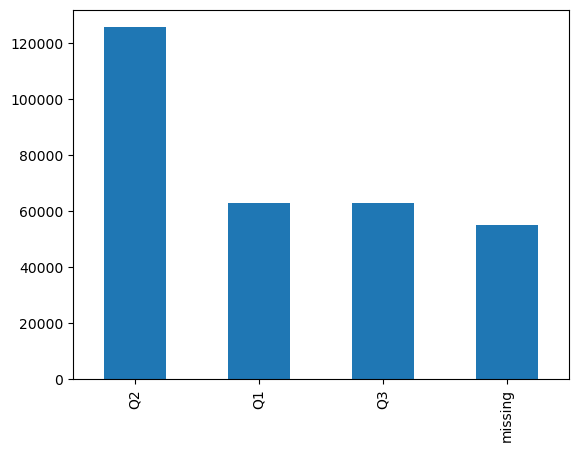

In [94]:
df['DAYS_EMPLOYED_iqr'].value_counts().plot(kind='bar')

In [95]:
# drop 'num_colunms_to_convert_to_categorical' from df after creating new column with '_iqr' suffix
df = drop_columns(df, num_colunms_to_convert_to_categorical)

In [96]:
df = add_missing_category(df, cat_colunms_to_convert_to_categorical)

In [97]:
cat_colunms_to_convert_to_categorical

['count_NAME_CONTRACT_TYPE_Consumer_loans',
 'count_CREDIT_TYPE_Mobile_operator_loan',
 'count_CREDIT_TYPE_Loan_for_business_development',
 'OBS_60_CNT_SOCIAL_CIRCLE',
 'count_CREDIT_TYPE_Another_type_of_loan',
 'count_NAME_PORTFOLIO_POS',
 'count_NAME_CASH_LOAN_PURPOSE_XNA',
 'OBS_30_CNT_SOCIAL_CIRCLE',
 'count_CREDIT_TYPE_Loan_for_working_capital_replenishment',
 'NAME_TYPE_SUITE',
 'count_CREDIT_TYPE_Cash_loan',
 'count_NAME_PORTFOLIO_Cash',
 'TOTAL_ENQUIRIES_CREDIT_BUREAU',
 'WALLSMATERIAL_MODE',
 'count_CREDIT_TYPE_Real_estate_loan',
 'OCCUPATION_TYPE',
 'CNT_FAM_MEMBERS',
 'count_CREDIT_CURRENCY_currency3',
 'count_CREDIT_ACTIVE_Bad_debt',
 'EMERGENCYSTATE_MODE',
 'count_CREDIT_TYPE_Interbank_credit',
 'count_CREDIT_CURRENCY_currency4',
 'count_CREDIT_TYPE_purchase_of_equipment',
 'count_CREDIT_TYPE_Creditc_card',
 'AMT_REQ_CREDIT_BUREAU_YEAR',
 'count_NAME_YIELD_GROUP_middle',
 'FONDKAPREMONT_MODE',
 'AMT_REQ_CREDIT_BUREAU_HOUR',
 'ELEVATORS_MODE',
 'count_CREDIT_TYPE_purchase_o

In [100]:
df = drop_columns(df, columns_to_drop)

In [101]:
df = create_missing_indicator(df, columns_to_create_missing_indicator)

In [102]:
df = impute_numerical_columns(df, numerical_columns_to_impute, num_cols, cat_cols, n_neighbors=5)

In [103]:
df = impute_categorical_columns(df, categorical_columns_to_impute)

In [104]:
df.isnull().sum()

TARGET                                                      0
NAME_CONTRACT_TYPE                                          0
CODE_GENDER                                                 0
FLAG_OWN_CAR                                                0
FLAG_OWN_REALTY                                             0
AMT_INCOME_TOTAL                                            0
AMT_ANNUITY                                                 0
AMT_GOODS_PRICE                                             0
NAME_TYPE_SUITE                                             0
NAME_INCOME_TYPE                                            0
NAME_EDUCATION_TYPE                                         0
NAME_FAMILY_STATUS                                          0
NAME_HOUSING_TYPE                                           0
REGION_POPULATION_RELATIVE                                  0
DAYS_BIRTH                                                  0
DAYS_REGISTRATION                                           0
DAYS_ID_

All the columns that still have missing values will be converted to categorical since we don't have enough information about the mechanism that created them.

In [61]:
df.isnull().sum()

budget                                                         0
original_language                                              0
status                                                         0
sw_collection                                                  0
sw_web_presence                                                0
sw_keywords                                                    0
revenue                                                        0
release_weekday                                                0
release_month                                                  0
release_quarter                                                0
release_year                                                   0
cat_runtime                                                    0
yearly_revenue_rank                                            0
yearly_percent_revenue                                         0
gender_ratio                                                   0
female_actors            

In [ ]:
# Create a heatmap using Seaborn
binary_missing_matrix_end_of_process = pd.DataFrame(np.where(df.notnull(), 0, 1), columns=df.columns, index=df.index)

plt.figure(figsize=(20,4))

sns.heatmap(binary_missing_matrix_end_of_process, cmap='binary', cbar=False)

# Set plot properties
plt.title('Missing Values Heatmap')
plt.xlabel('Columns')
plt.ylabel('Rows')

# Display the heatmap
plt.show()

In [69]:
IQR = num_colunms_to_convert_to_categorical 
add_missing_category = cat_colunms_to_convert_to_categorical
drop = columns_to_drop
create_missing_indicator = columns_to_create_missing_indicator
impute_numerical = numerical_columns_to_impute
impute_categorical = categorical_columns_to_impute
#convert_column_to_categorical = df.columns[df.isnull().any()].tolist()

# Create a dictionary to map action names to column lists
action_to_columns = {
    'create_iqr_quartile': IQR,
    'add_missing_category': add_missing_category,
    'drop': drop,
    'create_missing_indicator': create_missing_indicator,
    'impute_numerical': impute_numerical,
    'impute_categorical': impute_categorical
    #'convert_column_to_categorical': convert_to_categorical
}

# Fill the 'Outlier treatment' column based on the actions
for action, columns in action_to_columns.items():
    data_retrieval_protocol.loc[data_retrieval_protocol['Feature name'].isin(columns), 'Null treatment'] = action


In [73]:
data_retrieval_protocol

,Feature name,Source,Data type,Unique count,Min,Max,Num_of_Outliers,Outlier treatment,Num_of_Nulls,Null treatment,Description,%missing
0,TARGET,NaN,int64,2,0,1,NaN,NaN,0.0,NaN,NaN,0.000000
1,NAME_CONTRACT_TYPE,NaN,object,2,Revolving loans,Cash loans,NaN,NaN,0.0,NaN,NaN,0.000000
2,CODE_GENDER,NaN,object,3,XNA,F,NaN,NaN,0.0,NaN,NaN,0.000000
3,FLAG_OWN_CAR,NaN,int64,2,0,1,NaN,NaN,0.0,NaN,NaN,0.000000
4,FLAG_OWN_REALTY,NaN,int64,2,0,1,NaN,NaN,0.0,NaN,NaN,0.000000
5,CNT_CHILDREN,NaN,int64,15,0,19,NaN,NaN,NaN,NaN,NaN,NaN
6,AMT_INCOME_TOTAL,NaN,float64,2548,25650.0,117000000.0,14035 (4.56),log transformation,0.0,NaN,NaN,0.000000
7,AMT_CREDIT,NaN,float64,5603,45000.0,4050000.0,6562 (2.13),replace with NaN,6562.0,create_iqr_quartile,NaN,2.133907
8,AMT_ANNUITY,NaN,float64,13673,1615.5,258025.5,7504 (2.44),log transformation,12.0,impute_numerical,NaN,0.003902
9,AMT_GOODS_PRICE,NaN,float64,1003,40500.0,4050000.0,14728 (4.79),log transformation,278.0,impute_numerical,NaN,0.090403


In [72]:
#data_retrieval_protocol.drop('Null treatment\t', axis=1, inplace=True)

In [74]:
data_retrieval_protocol.to_excel('data_retrieval_protocol_home-credit-default-risk.xlsx')

Share Variables Across Notebooks:

In [105]:
%store df

Stored 'df' (DataFrame)


In [106]:
df.to_csv('clean_df_final_with_new_features.csv', index=True)